In [1]:
import pandas as pd
import re
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.decomposition import TruncatedSVD
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import contractions
import string
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt', force=True)
nltk.download('punkt_tab')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\HP\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\HP\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\HP\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping tokenizers\punkt.zip.
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\HP\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


True

In [2]:
#reading job data

job_description = pd.read_csv("dataset/job_data.csv", index_col=0)
job_data = pd.read_csv("dataset/Combined_Jobs_Final.csv", index_col=0)
job_data.reset_index(inplace=True)


In [3]:
mergedJobs = pd.merge(job_data, job_description, on='Job.ID', how='inner')

print("Job Data before any changes after merging all datasets\n")
mergedJobs.head()

Job Data before any changes after merging all datasets



,Job.ID,Provider,Status,Slug,Title,Position,Company,City,State.Name,State.Code,...,Job.Description,Requirements,Salary,Listing.Start,Listing.End,Employment.Type,Education.Required,Created.At,Updated.At,text
0,111,1,open,palo-alto-ca-tacolicious-server,Server @ Tacolicious,Server,Tacolicious,Palo Alto,California,CA,...,Tacolicious' first Palo Alto store just opened...,NaN,8.00,NaN,NaN,Part-Time,NaN,2013-03-12 02:08:28 UTC,2014-08-16 15:35:36 UTC,server tacolici palo alto part time tacolici f...
1,113,1,open,san-francisco-ca-claude-lane-kitchen-staff-chef,Kitchen Staff/Chef @ Claude Lane,Kitchen Staff/Chef,Claude Lane,San Francisco,California,CA,...,\r\n\r\nNew French Brasserie in S.F. Financia...,NaN,0.00,NaN,NaN,Part-Time,NaN,2013-04-12 08:36:36 UTC,2014-08-16 15:35:36 UTC,kitchen staff chef claud lane san francisco pa...
2,117,1,open,san-francisco-ca-machka-restaurants-corp-barte...,Bartender @ Machka Restaurants Corp.,Bartender,Machka Restaurants Corp.,San Francisco,California,CA,...,We are a popular Mediterranean wine bar and re...,NaN,11.00,NaN,NaN,Part-Time,NaN,2013-07-16 09:34:10 UTC,2014-08-16 15:35:37 UTC,bartend machka restaur corp. san francisco par...
3,121,1,open,brisbane-ca-teriyaki-house-server,Server @ Teriyaki House,Server,Teriyaki House,Brisbane,California,CA,...,● Serve food/drinks to customers in a profess...,NaN,10.55,NaN,NaN,Part-Time,NaN,2013-09-04 15:40:30 UTC,2014-08-16 15:35:38 UTC,server teriyaki hous brisban part time serv fo...
4,127,1,open,los-angeles-ca-rosa-mexicano-sunset-kitchen-st...,Kitchen Staff/Chef @ Rosa Mexicano - Sunset,Kitchen Staff/Chef,Rosa Mexicano - Sunset,Los Angeles,California,CA,...,"Located at the heart of Hollywood, we are one ...",NaN,10.55,NaN,NaN,Part-Time,NaN,2013-07-17 15:26:18 UTC,2014-08-16 15:35:40 UTC,kitchen staff chef rosa mexicano sunset lo ang...


number of jobs before data preprocessing 84090


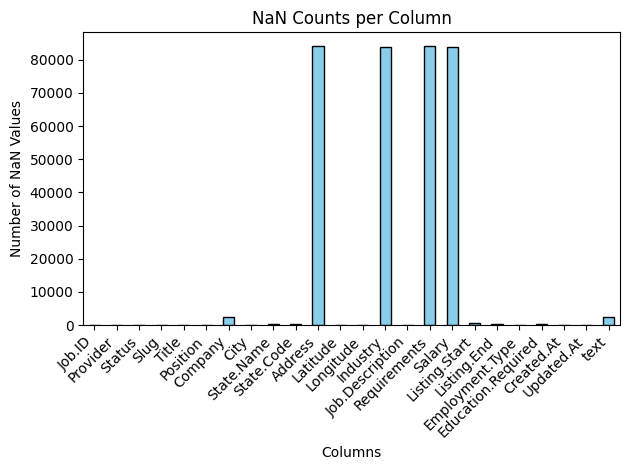

In [5]:
nan_counts = mergedJobs.isna().sum()
print("number of jobs before data preprocessing",len(mergedJobs))
# Plot
nan_counts.plot(kind='bar', color='skyblue', edgecolor='black')
plt.title('NaN Counts per Column')
plt.xlabel('Columns')
plt.ylabel('Number of NaN Values')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [6]:
#Address, Salary, Requirements contains a lot of NaNs so they are dropped. rest will not be used in the training process
#but we can use them to filter jobs based on some threshold "like distance or seeing if the two cities are in same range or not"
columns_to_drop = ['Address', 'Salary', 'Industry', 'Provider', 'Company', 'Latitude', 'Slug','Longitude', 'State.Code', 'Listing.Start', 'Listing.End', 'Updated.At', 'Created.At', 'Education.Required', 'Employment.Type', 'City', 'State.Name']
mergedJobs.drop(columns=[col for col in columns_to_drop if col in mergedJobs.columns], inplace=True)

mergedJobs = mergedJobs[mergedJobs['Status'].str.lower() == 'open']
mergedJobs.dropna(subset=['Job.Description'], inplace=True)
mergedJobs.dropna(subset=['Title'], inplace=True)
mergedJobs.dropna(subset=['Position'], inplace=True)

mergedJobs.drop(columns=['Status'], inplace=True) #They are all open

#keeping only id and combined_text for TF-IDF
print("columns before combining\n",mergedJobs.columns)

#here i repeated the title and position twice, to give them more weight since that they have more meaning 
#and already small in number related to text and description (showed very big upgrade in performance when applied)
mergedJobs['combined_text'] = 'title: ' + mergedJobs['Title'].fillna('') + ' ' + mergedJobs['Title'].fillna('') + ' ' + 'position: ' + mergedJobs['Position'].fillna('') + ' ' + mergedJobs['Position'].fillna('') + ' '+ 'description: ' + mergedJobs['Job.Description'].fillna('') + ' ' + mergedJobs['text'] + mergedJobs['Requirements'].fillna('')

mergedJobs = mergedJobs[['Job.ID', 'combined_text']]



print("jobs data after combining text fields into one\n")
mergedJobs.head()


columns before combining
 Index(['Job.ID', 'Title', 'Position', 'Job.Description', 'Requirements',
       'text'],
      dtype='object')
jobs data after combining text fields into one



,Job.ID,combined_text
0,111,title: Server @ Tacolicious Server @ Tacolicio...
1,113,title: Kitchen Staff/Chef @ Claude Lane Kitche...
2,117,title: Bartender @ Machka Restaurants Corp. Ba...
3,121,title: Server @ Teriyaki House Server @ Teriya...
4,127,title: Kitchen Staff/Chef @ Rosa Mexicano - Su...


In [8]:
stop_words = set(stopwords.words('english'))
lemmatizer = WordNetLemmatizer()
#Function to clean text, removing stopwords and lowering all words
def clean_text(text):
    if pd.isna(text):
        return ""
    
    text = text.lower()
    text = text.replace('/', ' ')  # Replace slashes with a space
    text = re.sub(r'\d+', '', text)
    
    text = text.translate(str.maketrans('', '', string.punctuation))
    
    text = re.sub(r'\s+', ' ', text).strip()
    
    text = contractions.fix(text)
    
    tokens = nltk.word_tokenize(text)
    tokens = [word for word in tokens if word not in stop_words and len(word) > 1]
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)



#combining text columns and cleaning them
mergedJobs['cleaned_text'] = mergedJobs['combined_text'].apply(clean_text)
mergedJobs = mergedJobs[['Job.ID', 'cleaned_text']]
print(mergedJobs.columns)
mergedJobs.head()


Index(['Job.ID', 'cleaned_text'], dtype='object')


,Job.ID,cleaned_text
0,111,title server tacolicious server tacolicious po...
1,113,title kitchen staff chef claude lane kitchen s...
2,117,title bartender machka restaurant corp bartend...
3,121,title server teriyaki house server teriyaki ho...
4,127,title kitchen staff chef rosa mexicano sunset ...


length before cleaning experience 8653


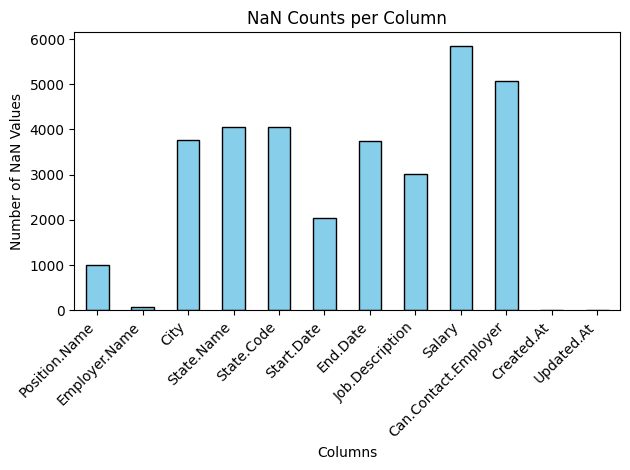

In [9]:
applicant_experience = pd.read_csv("dataset/Experience.csv", index_col=0)
print("length before cleaning experience" , len(applicant_experience))
nan_counts = applicant_experience.isna().sum()
# Plot
applicant_experience.reset_index(inplace=True)
nan_counts.plot(kind='bar', color='skyblue', edgecolor='black')
plt.title('NaN Counts per Column')
plt.xlabel('Columns')
plt.ylabel('Number of NaN Values')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

length before cleaning interests 6560


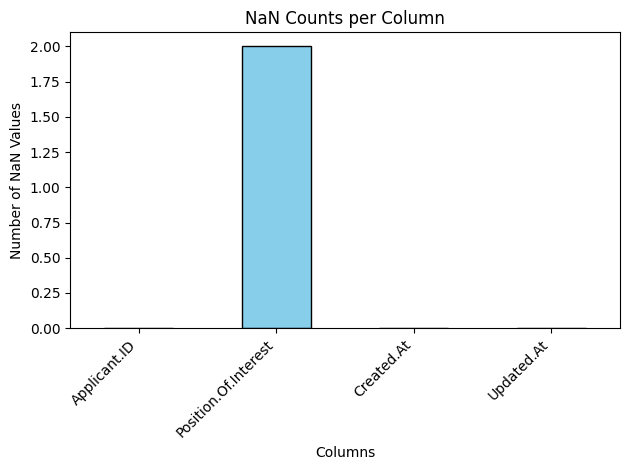

In [10]:
applicant_positions_interest = pd.read_csv("dataset/Positions_Of_Interest.csv", index_col=0)
applicant_positions_interest.reset_index(inplace=True)
print("length before cleaning interests" , len(applicant_positions_interest))

nan_counts = applicant_positions_interest.isna().sum()
# Plot

nan_counts.plot(kind='bar', color='skyblue', edgecolor='black')
plt.title('NaN Counts per Column')
plt.xlabel('Columns')
plt.ylabel('Number of NaN Values')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

17822


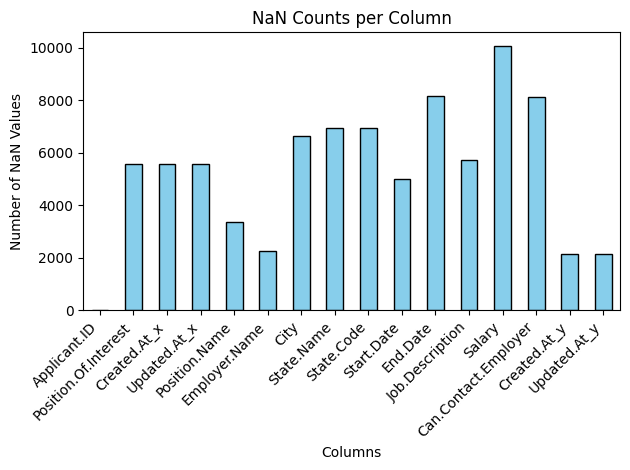

In [11]:
interest_experince_merge = pd.merge(applicant_positions_interest, applicant_experience, on=['Applicant.ID'], how='outer')

nan_counts = interest_experince_merge.isna().sum()
print(len(interest_experince_merge))
# Plot
nan_counts.plot(kind='bar', color='skyblue', edgecolor='black')
plt.title('NaN Counts per Column')
plt.xlabel('Columns')
plt.ylabel('Number of NaN Values')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [12]:
# applicant_experience = pd.read_csv("dataset/Experience.csv", index_col=0)
applicant_interestsExperience_train, applicant_interestsExperience_test = train_test_split(
    interest_experince_merge,
    test_size=0.2,         # 80/20 split
    random_state=42,       # for reproducibility
)

applicant_interestsExperience_train = applicant_interestsExperience_train.drop(columns=['Salary','Can.Contact.Employer','Updated.At_x','Created.At_x','Created.At_y', 'State.Name', 'State.Code', 'City','Start.Date','End.Date', 'Updated.At_y', 'Employer.Name'])
###Drop the row if all three are nan
applicant_interestsExperience_train = applicant_interestsExperience_train.dropna(subset=['Position.Name', 'Job.Description', 'Position.Of.Interest'], how='all')

print(applicant_interestsExperience_train.columns)
print("length after cleaning" , len(applicant_interestsExperience_train))

applicant_interestsExperience_train.head()

Index(['Applicant.ID', 'Position.Of.Interest', 'Position.Name',
       'Job.Description'],
      dtype='object')
length after cleaning 13594


,Applicant.ID,Position.Of.Interest,Position.Name,Job.Description
15076,12468,NaN,IT Intern,Traveled to out of state offices\r\nCommuted t...
14756,11800,NaN,Global Public Relations/Social Media Intern,- Update and manage Logitech.com United States...
3433,2878,Customer Service Rep,Visual Merchandiser,•\tDesigned visual displays and executed desig...
1586,2283,Host,Salon Upkeep,"Cleaned Salon ,bathrooms, floors, windows, mir..."
1395,2238,Customer Service Rep,Sales Associate,•\tUsed POS system to generate sales totals\r\...


In [13]:
applicant_interestsExperience_train['description'] ='title ' + ' ' + applicant_interestsExperience_train['Position.Of.Interest'].fillna('') + ' ' + applicant_interestsExperience_train['Position.Of.Interest'].fillna('') + ' ' + 'position ' + applicant_interestsExperience_train['Position.Name'] + ' ' + applicant_interestsExperience_train['Position.Name'] + ' ' + applicant_interestsExperience_train['Job.Description'].fillna('') 

applicant_interestsExperience_train = applicant_interestsExperience_train.drop(columns=['Position.Name', 'Job.Description','Position.Of.Interest'])


#Because some applicants appear twice in the same dataset, instead of being in different rows, i combined their description
# Group by 'Applicant.ID' and combine the descriptions with a dot separating them
applicant_interestsExperience_train = applicant_interestsExperience_train.dropna(subset=['description'])
applicant_interestsExperience_train = applicant_interestsExperience_train.groupby('Applicant.ID')['description']\
    .apply(lambda x: ' . '.join(x))\
    .reset_index()

applicant_interestsExperience_train.head()



,Applicant.ID,description
0,2,title position Volunteer Volunteer * Read a...
1,3,title position Marketing Intern Marketing I...
2,8,"title position deli clerk,server, cashier, ..."
3,11,title position Cashier Cashier
4,12,title position IT Program Management Intern...


In [14]:
applicant_interestsExperience_train['cleaned_text'] = applicant_interestsExperience_train['description'].apply(clean_text)
applicant_interestsExperience_train.drop(columns=['description'], inplace=True)

applicant_interestsExperience_train.head()

,Applicant.ID,cleaned_text
0,2,title position volunteer volunteer read aloud ...
1,3,title position marketing intern marketing inte...
2,8,title position deli clerkserver cashier food p...
3,11,title position cashier cashier
4,12,title position program management intern progr...


In [16]:

#sublinear for better normalization
vectorizer = TfidfVectorizer(max_features=5000, ngram_range=(1,3), sublinear_tf=True) #ngrams to capture things like "software eningeering" more efficeintly

#fit vectorizer on jobs, put applicants and jobs in same vector space
job_tfidf = vectorizer.fit_transform(mergedJobs['cleaned_text']) #convert text into numerical distance based on frequency
applicant_tfidf = vectorizer.transform(applicant_interestsExperience_train['cleaned_text'])

###Used it to reduce memory usage, needed around 8 gigs of ram
svd = TruncatedSVD(n_components=300, random_state=42) 

# Fit and transform the job descriptions
job_tfidf_reduced = svd.fit_transform(job_tfidf)# to reduce dimenstionality and (showed better scores)

# Transform the applicant descriptions (do not fit, only transform)
applicant_tfidf_reduced = svd.transform(applicant_tfidf)

contentBased_similarity_matrix = cosine_similarity(applicant_tfidf_reduced, job_tfidf_reduced).astype(np.float32)


In [18]:

applicant_interestsExperience_test = applicant_interestsExperience_test.drop(columns=['Salary','Can.Contact.Employer','Updated.At_x','Created.At_x','Created.At_y', 'State.Name', 'State.Code', 'City','Start.Date','End.Date', 'Updated.At_y', 'Employer.Name'])
###Drop the row if all three are nan
applicant_interestsExperience_test = applicant_interestsExperience_test.dropna(subset=['Position.Name', 'Job.Description', 'Position.Of.Interest'], how='all')

print(applicant_interestsExperience_test.columns)
applicant_interestsExperience_test['description'] ='title ' + ' ' + applicant_interestsExperience_test['Position.Of.Interest'].fillna('') + ' ' + applicant_interestsExperience_test['Position.Of.Interest'].fillna('') + ' ' + 'position ' + applicant_interestsExperience_test['Position.Name'] + ' ' + applicant_interestsExperience_test['Position.Name'] + ' ' + applicant_interestsExperience_test['Job.Description'].fillna('') 

applicant_interestsExperience_test = applicant_interestsExperience_test.drop(columns=['Position.Name', 'Job.Description','Position.Of.Interest'])
applicant_interestsExperience_test = applicant_interestsExperience_test.dropna(subset=['description'])
print(applicant_interestsExperience_test.columns)
applicant_interestsExperience_test.head()

Index(['Applicant.ID', 'Position.Of.Interest', 'Position.Name',
       'Job.Description'],
      dtype='object')
Index(['Applicant.ID', 'description'], dtype='object')


,Applicant.ID,description
9390,6428,title Customer Service Rep Customer Service R...
9366,6425,title Customer Service Rep Customer Service R...
11043,7895,title position Cashier Cashier
2662,2641,title cashier cashier position data imaging d...
8762,5919,title position Sales Associate Sales Associ...


In [19]:
applicant_interestsExperience_test = applicant_interestsExperience_test.groupby('Applicant.ID')['description']\
    .apply(lambda x: ' . '.join(x))\
    .reset_index()

applicant_interestsExperience_test['cleaned_text'] = applicant_interestsExperience_test['description'].apply(clean_text)

applicant_interestsExperience_test.drop(columns=['description'], inplace=True)

applicant_interestsExperience_test.head()

,Applicant.ID,cleaned_text
0,2,title position writer uloop blog writer uloop ...
1,3,title position server server
2,6,title position project assistant project assis...
3,12,title position server server
4,14,title position waitress waitress


In [20]:
# Assuming vectorizer is already fitted on the training data

#transforming test applicants to trained vectorizer
applicant_tfidf_test = vectorizer.transform(applicant_interestsExperience_test['cleaned_text'])

# applying PCA as we did during training to maintain same shape
applicant_tfidf_test_reduced = svd.transform(applicant_tfidf_test)


# Compute similarity matrix for test data
contentBased_similarity_matrix_test = cosine_similarity(applicant_tfidf_test_reduced, job_tfidf_reduced).astype(np.float32)




In [21]:
top_k = 5
recommendations_test = {}

# For each test applicant, get top-k recommended jobs
for i, applicant_id in enumerate(applicant_interestsExperience_test['Applicant.ID']):
    job_indices = contentBased_similarity_matrix_test[i].argsort()[::-1][:top_k]  # Get indices of top-k jobs
    recommended_jobs = mergedJobs.iloc[job_indices]['Job.ID'].tolist()
    recommendations_test[applicant_id] = recommended_jobs

# Print the recommendations for each test applicant
for app_id, recs in recommendations_test.items():
    print(f"Applicant {app_id} recommended jobs:")
    for job_id in recs:
        job_row = mergedJobs[mergedJobs['Job.ID'] == job_id]
        if not job_row.empty:
            job_desc = job_row.iloc[0]['cleaned_text']
            print(f" - Job ID {job_id}: {job_desc}")
        else:
            print(f" - Job ID {job_id} not found in mergedJobs.")





Applicant 2 recommended jobs:
 - Job ID 283669: title mathematics parttime faculty noncredit community college philadelphia mathematics parttime faculty noncredit community college philadelphia position mathematics parttime faculty noncredit mathematics parttime faculty noncredit description community college philadelphia largest public institution higher education city since student passed door seeking associate degree certificate improved workplace skill lifelong learning many degree student transfer fouryear institution others seek employment philadelphia region percent graduate remain area seek employment strengthening local economy workforce local business look u provide workplace training keep worker skilled company competitive trio upward bound program search experienced energetic high school mathematics teacher facilitate introduction algebra geometry sat review rising thth grader philadelphia school district participating extracurricular college prep program specific responsib

In [22]:
###Content BASED

# Step 1: Input text
input_text = input("Describe your skills and experience: ")

# Step 2: Clean
cleaned_input = clean_text(input_text)

# Step 3: Vectorize (IMPORTANT: use .transform, not .fit_transform)
input_tfidf = vectorizer.transform([cleaned_input])

# Step 4: Reduce dimensions
input_reduced = svd.transform(input_tfidf)

# Step 5: Compute similarity with all jobs
input_similarity = cosine_similarity(input_reduced, job_tfidf_reduced).flatten()

# Step 6: Get top 5 recommended job indices
top_indices = np.argsort(-input_similarity)[:5]

# Step 7: Show results
print("\nTop 5 job recommendations:\n")
for idx in top_indices:
    print(f"- {mergedJobs.iloc[idx]['cleaned_text']} (Similarity: {input_similarity[idx]:.4f})")



Top 5 job recommendations:

- title lead assistant teacher abc early childhood learning center lead assistant teacher abc early childhood learning center position lead assistant teacher lead assistant teacher description lead teacher nbsp assistant teacher lead assist teacher abc earli childhood learn center cincinnati full time part time lead teacher nbsp assist teacher (Similarity: 0.7765)
- title assistant teacher goddard school assistant teacher goddard school position assistant teacher assistant teacher description teaching child six week six year age using curriculum designed help kindergarten readynbsp assist teacher goddard school sugar land part time teach child six week six year age use curriculum design help kindergarten ready nbsp (Similarity: 0.7668)
- title assistant teacher la petite academy assistant teacher la petite academy position assistant teacher assistant teacher description la petite academy miamisburg hiring assistant teacher childcare facility located spring 

In [23]:
def similarity_threshold_score_topk(similarity_matrix, threshold, k=5):
    topk_similarities = np.sort(similarity_matrix, axis=1)[:, -k:]
    passed = (topk_similarities >= threshold).astype(int)
    score = np.mean(np.any(passed, axis=1))  # any of the top k passed
    return score

contentBased_threshold_score = similarity_threshold_score_topk(contentBased_similarity_matrix_test, threshold=0.6, k=5)
print(f"Thresholded similarity score (top-5): {contentBased_threshold_score:.4f}")

Thresholded similarity score (top-5): 0.5544


In [24]:
def mean_similarity_topk(similarity_matrix, k=5):
    topk_similarities = np.sort(similarity_matrix, axis=1)[:, -k:]
    return np.mean(topk_similarities)
contentBased_MAE_score = mean_similarity_topk(contentBased_similarity_matrix_test, k=5)
print(f"MAE similarity score (top-5): {contentBased_MAE_score:.4f}")

MAE similarity score (top-5): 0.5975


In [ ]:
# # Define Precision@k for normal and positive sampling
# def normal_precision_at_k(final_scores, ground_truth_views, applicant_ids, job_ids, k=5):
#     correct = 0
#     total = 0

#     ground_truth = {}
#     for _, row in ground_truth_views.iterrows():
#         app_id = row['Applicant.ID']
#         job_id = row['Job.ID']
#         if app_id not in ground_truth:
#             ground_truth[app_id] = set()
#         ground_truth[app_id].add(job_id)

#     inv_app_index = {v: k for k, v in app_index.items()}
#     inv_job_index = {v: k for k, v in job_index.items()}

#     for app_idx in range(final_scores.shape[0]):
#         app_id = inv_app_index.get(app_idx)
#         if app_id is None:
#             continue

#         if app_id not in ground_truth or len(ground_truth[app_id]) == 0:
#             continue

#         top_k_job_indices = np.argsort(final_scores[app_idx])[::-1][:k]
#         predicted_jobs = [inv_job_index[job_idx] for job_idx in top_k_job_indices]

#         if any(job in ground_truth[app_id] for job in predicted_jobs):
#             correct += 1

#         total += 1

#     if total == 0:
#         return 0.0

#     precision = correct / total
#     return precision

# # Define Precision@k with positive sampling
# def precision_at_k_with_positive_sampling(final_scores, ground_truth_views, applicant_ids, job_ids, job_tfidf, top_similar_jobs=3, k=5):
#     correct = 0
#     total = 0

#     ground_truth = {}
#     for _, row in ground_truth_views.iterrows():
#         app_id = row['Applicant.ID']
#         job_id = row['Job.ID']
#         if app_id not in ground_truth:
#             ground_truth[app_id] = set()
#         ground_truth[app_id].add(job_id)

#     job_to_job_sim = cosine_similarity(job_tfidf)

#     inv_app_index = {v: k for k, v in app_index.items()}
#     inv_job_index = {v: k for k, v in job_index.items()}

#     job_similar_jobs = {}
#     for job_idx in range(job_to_job_sim.shape[0]):
#         similar_indices = np.argsort(job_to_job_sim[job_idx])[::-1]
#         similar_jobs = [inv_job_index[idx] for idx in similar_indices[1:top_similar_jobs+1]]
#         job_similar_jobs[inv_job_index[job_idx]] = similar_jobs

#     for app_idx in range(final_scores.shape[0]):
#         app_id = inv_app_index.get(app_idx)
#         if app_id is None:
#             continue

#         if app_id not in ground_truth or len(ground_truth[app_id]) == 0:
#             continue

#         expanded_ground_truth = set(ground_truth[app_id])
#         for job in ground_truth[app_id]:
#             if job in job_similar_jobs:
#                 expanded_ground_truth.update(job_similar_jobs[job])

#         top_k_job_indices = np.argsort(final_scores[app_idx])[::-1][:k]
#         predicted_jobs = [inv_job_index[job_idx] for job_idx in top_k_job_indices]

#         if any(job in expanded_ground_truth for job in predicted_jobs):
#             correct += 1

#         total += 1

#     if total == 0:
#         return 0.0

#     precision = correct / total
#     return precision

# # Now, let's compute both metrics and print them side by side
# normal_precision = normal_precision_at_k(final_scores, cleaned_applicant_job_views, applicant_interestsExperience_train['Applicant.ID'], mergedJobs['Job.ID'], k=5)
# print(f"Normal Precision@5: {normal_precision:.4f}")

# # positive_sampling_precision = precision_at_k_with_positive_sampling(final_scores, cleaned_applicant_job_views, applicant_interestsExperience_train['Applicant.ID'], mergedJobs['Job.ID'], job_tfidf, top_similar_jobs=3, k=5)
# # print(f"Precision@5 with Positive Sampling: {positive_sampling_precision:.4f}")


In [ ]:
# def recall_at_k(similarity_matrix, ground_truth, k=5):
#     recalls = []
#     for applicant_idx in range(similarity_matrix.shape[0]):
#         top_k_jobs = np.argsort(similarity_matrix[applicant_idx])[::-1][:k]
#         true_jobs = ground_truth.get(applicant_idx, set())
#         if true_jobs:
#             recall = len(set(top_k_jobs) & true_jobs) / len(true_jobs)
#             recalls.append(recall)
#     return np.mean(recalls)

# def mrr(similarity_matrix, ground_truth):
#     mrrs = []
#     for applicant_idx in range(similarity_matrix.shape[0]):
#         sorted_jobs = np.argsort(similarity_matrix[applicant_idx])[::-1]
#         true_jobs = ground_truth.get(applicant_idx, set())
#         for rank, job_idx in enumerate(sorted_jobs):
#             if job_idx in true_jobs:
#                 mrrs.append(1.0 / (rank + 1))
#                 break
#         else:
#             mrrs.append(0.0)
#     return np.mean(mrrs)

# def ndcg_at_k(similarity_matrix, ground_truth, k=5):
#     ndcgs = []
#     for applicant_idx in range(similarity_matrix.shape[0]):
#         sorted_jobs = np.argsort(similarity_matrix[applicant_idx])[::-1][:k]
#         true_jobs = ground_truth.get(applicant_idx, set())
#         dcg = 0.0
#         for i, job_idx in enumerate(sorted_jobs):
#             if job_idx in true_jobs:
#                 dcg += 1 / np.log2(i + 2)  # i + 2 because i starts at 0
#         ideal_dcg = sum(1 / np.log2(i + 2) for i in range(min(len(true_jobs), k)))
#         ndcg = dcg / ideal_dcg if ideal_dcg > 0 else 0.0
#         ndcgs.append(ndcg)
#     return np.mean(ndcgs)


In [25]:
applicant_job_views = pd.read_csv("dataset/job_views.csv", index_col=0)
applicant_job_views.reset_index(inplace=True)



na_counts = applicant_job_views.isna().sum().sort_values(ascending=False)
print("length before cleaning" , len(applicant_job_views))
print(na_counts)
cleaned_applicant_job_views = applicant_job_views.drop(columns=['Industry','View.End','Company', 'State.Name', 'State.Code', 'City','View.Start', 'Created.At', 'Updated.At'])
cleaned_applicant_job_views = cleaned_applicant_job_views.dropna(subset=['View.Duration'])
print("length after cleaning" , len(cleaned_applicant_job_views))



cleaned_applicant_job_views['job_info'] = cleaned_applicant_job_views.apply(
    lambda row: ' '.join(str(row[col]) for col in ['Title', 'Position'] if pd.notna(row[col])),
    axis=1
)

cleaned_applicant_job_views.drop(columns=['Title', 'Position'], inplace=True)

cleaned_applicant_job_views['job_info'] = cleaned_applicant_job_views['job_info'].apply(clean_text)

applicant_job_views_train, applicant_job_views_test = train_test_split(
    cleaned_applicant_job_views,
    test_size=0.2,         # 80/20 split
    random_state=42,       # for reproducibility
)

applicant_job_views_train.head()

length before cleaning 12370
Industry         10171
View.End          1795
View.Duration     1795
Company            580
State.Name          22
State.Code          22
Applicant.ID         0
Job.ID               0
Title                0
Position             0
City                 0
View.Start           0
Created.At           0
Updated.At           0
dtype: int64
length after cleaning 10575


,Applicant.ID,Job.ID,View.Duration,job_info
5703,12845,146523,16.0,data entry clerk officeteam data entry clerk
411,10195,149615,15.0,social work family service league social work
1910,11026,85504,63.0,digital platform sale executive usa global glo...
9320,6844,47503,15.0,imaging pbx assoc prn palm west hospital imagi...
949,10504,100625,46.0,city driver parttime combined dock pd abf frei...


In [ ]:
from sklearn.neighbors import NearestNeighbors

job_descriptions_lookup = pd.concat([
    applicant_job_views_train[['Job.ID', 'job_info']],
    applicant_job_views_test[['Job.ID', 'job_info']]
]).drop_duplicates(subset='Job.ID').set_index('Job.ID')['job_info']

view_matrix_train = applicant_job_views_train.pivot_table(
    index='Applicant.ID',
    columns='Job.ID',
    values='View.Duration',
    fill_value=0
)

#divide by applicants max view duration to reduce bias from applicants who watch everything longer
interaction_matrix_train = view_matrix_train.div(view_matrix_train.max(axis=1).replace(0, 1e-8), axis=0)

view_matrix_test = applicant_job_views_test.pivot_table(
    index='Applicant.ID',
    columns='Job.ID',
    values='View.Duration',
    fill_value=0
)

interaction_matrix_test = view_matrix_test.div(view_matrix_test.max(axis=1).replace(0, 1e-8), axis=0)
interaction_matrix_test = interaction_matrix_test.reindex(columns=interaction_matrix_train.columns, fill_value=0)
# interaction_matrix_test = view_matrix_test
knn_model = NearestNeighbors(n_neighbors=5,
                             metric='cosine',
                             algorithm='brute')
knn_model.fit(interaction_matrix_train.values)

train_applicant_ids = interaction_matrix_train.index.to_list()
test_applicant_ids = interaction_matrix_test.index.to_list()

In [28]:
def knn_collaborative_recommender(test_index, top_k=5, num_recs=5, by='solo'):
    test_vector = interaction_matrix_test.iloc[test_index].values.reshape(1, -1)

    distances, neighbor_indices = knn_model.kneighbors(test_vector, n_neighbors=top_k)

    distances = distances.flatten()
    neighbor_indices = neighbor_indices.flatten()

    # zero means that this is the applicant, remove that neighbor because its test applicant
    if distances[0] == 0.0:
        distances = distances[1:]
        neighbor_indices = neighbor_indices[1:]

    similarities = 1 - distances[:top_k]
    neighbor_indices = neighbor_indices[:top_k]

    if len(neighbor_indices) == 0:
        return [], []

    similar_user_matrix = interaction_matrix_train.iloc[neighbor_indices]

    #here what happens is, see jobs that similar users showed, so if job A was viewed by users whos similarities are 1 and 0.9,
    # job b viewed by users whos sim are 0.4 and 0.6. then job A is higher in score
    weighted_scores = np.dot(similarities, similar_user_matrix.values)
    score_series = pd.Series(weighted_scores, index=interaction_matrix_train.columns)

    seen_jobs = interaction_matrix_test.iloc[test_index] > 0
    score_series = score_series[~seen_jobs]

    if by == 'solo':
        return score_series.sort_values(ascending=False).head(num_recs).index.tolist(), distances[:top_k]
    elif by == 'hybrid':
        return score_series.reindex(interaction_matrix_train.columns, fill_value=0), distances[:top_k]





In [29]:
msa_values = []

for i, test_applicant_id in enumerate(test_applicant_ids):
    rec_job_ids, distances = knn_collaborative_recommender(i, by='solo')

    # Calculate MSA from distances (skip self at index 0)
    if len(distances) > 1:
        similarities = 1 - np.array(distances[1:])  # Convert distances to similarities
        msa = np.mean(1 - similarities)             # Dissimilarity
        msa_values.append(msa)
    else:
        msa = None

    print(f"\nRecommended jobs for test applicant {test_applicant_id}:")
    for job_id in rec_job_ids:
        desc = job_descriptions_lookup.get(job_id, "No description found.")
        print(f"  - {desc}")
    # print(cleaned_applicant_job_views[cleaned_applicant_job_views['Applicant.ID'] == test_applicant_id]['job_info'])


# Calculate and print the average MSA
collaboratove_knn_msa = np.mean(msa_values) if msa_values else 0.0
print(f"\n✅ Average MSA across all test applicants: {collaboratove_knn_msa:.4f}")



Recommended jobs for test applicant 42:
  - customer service bayer healthcare customer service
  - entry level sale customer service part time full time vector marketing entry level sale customer service part time full time
  - switchboard operator axiom staffing group switchboard operator
  - call cook quad graphic call cook
  - part time customer service teller bilingual spanishenglish fifth third bank part time customer service teller bilingual spanishenglish

Recommended jobs for test applicant 153:
  - customer service rep ii zion bancorporation california bank trust customer service rep ii
  - underwriting assistant accountemps underwriting assistant
  - server susumu japanese steak house server
  - valic financial advisor intern roseville ca aig corp valic financial advisor intern roseville ca
  - financial analyst accountemps financial analyst

Recommended jobs for test applicant 601:
  - personal assistant administrative assistant quest llc personal assistant administrative a

In [30]:

train_density = (interaction_matrix_train > 0).sum(axis=1)
test_density = (interaction_matrix_test > 0).sum(axis=1)

print("Train interaction density:")
print(train_density.describe())

print("Test interaction density:")
print(test_density.describe())


Train interaction density:
count    2819.000000
mean        2.335580
std         2.497162
min         0.000000
25%         1.000000
50%         1.000000
75%         3.000000
max        42.000000
dtype: float64
Test interaction density:
count    1304.000000
mean        0.796012
std         0.930320
min         0.000000
25%         0.000000
50%         1.000000
75%         1.000000
max        10.000000
dtype: float64


In [31]:
#Normalizing view durations for each applicant
view_matrix = applicant_job_views_train.pivot_table(
    index='Applicant.ID',
    columns='Job.ID',
    values='View.Duration',
    fill_value=0
)

# Normalize each applicants view duration by its max to prevent bias
row_max = view_matrix.max(axis=1).replace(0, 1e-8)
interaction_matrix = view_matrix.div(row_max, axis=0)

#sim between users
user_sim = cosine_similarity(interaction_matrix)

# #Mapping from IDs to indices
# applicant_index_to_id = interaction_matrix.index.to_list()
# applicant_id_to_index = {aid: idx for idx, aid in enumerate(applicant_index_to_id)}



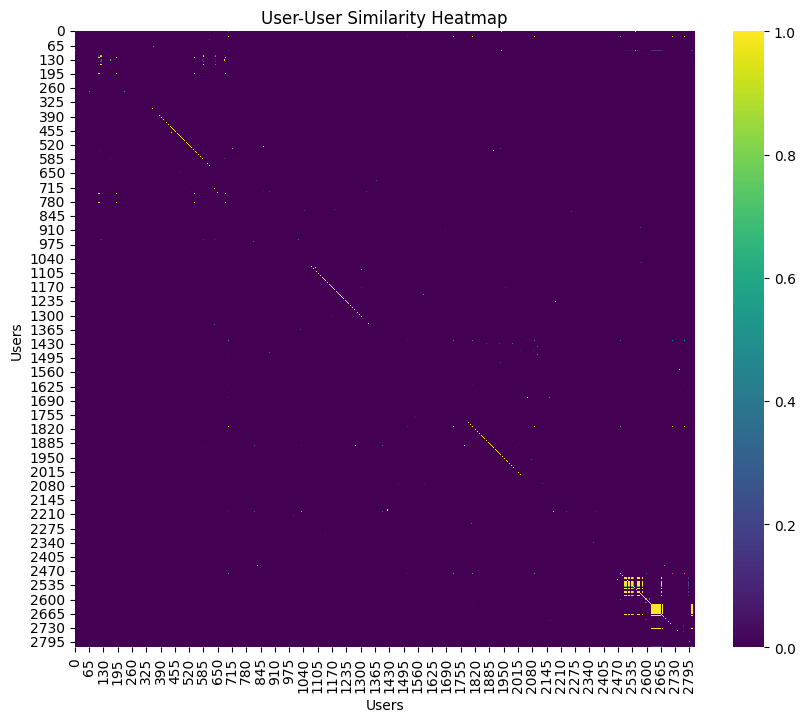

In [32]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 8))
sns.heatmap(user_sim, cmap='viridis')
plt.title("User-User Similarity Heatmap")
plt.xlabel("Users")
plt.ylabel("Users")
plt.show()


In [33]:
def hybrid_recommender(applicant_row, alpha=0.5, top_k=5, num_recs=5):
    applicant_id = applicant_row['Applicant.ID']
    applicant_text_data = applicant_row['cleaned_text']

    # Collaborative filtering if the user is in training data of views (had previous interactions)
    if applicant_id in test_applicant_ids:
        test_index = test_applicant_ids.index(applicant_id)
        collab_series, _ = knn_collaborative_recommender(test_index, top_k=top_k, by='hybrid')
    else:
        collab_series = pd.Series(0, index=interaction_matrix_train.columns)


    # Content-based: Always transform applicant's description
    tfidf = vectorizer.transform([applicant_text_data])
    reduced = svd.transform(tfidf)
    content_scores = cosine_similarity(reduced, job_tfidf_reduced)[0]
    content_series = pd.Series(content_scores, index=mergedJobs['Job.ID'])


    #handling indexes (convering same indexes to avoid mismatch while combining scores)
    combined_index = content_series.index.union(collab_series.index)
    content_series = content_series.reindex(combined_index, fill_value=0)
    collab_series = collab_series.reindex(combined_index, fill_value=0)

    # Combine scores
    hybrid_scores = alpha * content_series + (1 - alpha) * collab_series
    top_jobs = hybrid_scores.sort_values(ascending=False).head(num_recs).index


    results = []
    for job_id in top_jobs:
        source = "Content-based" if content_series[job_id] > collab_series[job_id] else "Collaborative"
        
        desc = mergedJobs.loc[mergedJobs['Job.ID'] == job_id, 'cleaned_text'].values
        if len(desc) > 0:
            description = desc[0]
        else:
            description = job_descriptions_lookup.get(job_id, "Description not found")

        results.append((job_id, source, description, hybrid_scores[job_id]))

    return results



In [35]:
msa_values_6 = []  # Store MSA per applicant

for idx, row in applicant_interestsExperience_test.iterrows():  # Or however you're iterating applicants
    rec_jobs = hybrid_recommender(row, alpha=0.6)  # Your function to generate hybrid recs
    applicant_msa_scores = []

    for job_id, source, description, score in rec_jobs:
        dissimilarity = 1 - score
        applicant_msa_scores.append(dissimilarity)

        print(f" job_id: {job_id} - applicantiD:{row['Applicant.ID']} Source: {source} - {description} score: {score:.4f}")

    if applicant_msa_scores:
        applicant_msa = np.mean(applicant_msa_scores)
        msa_values_6.append(applicant_msa)

hybrid_average_msa = np.mean(msa_values_6) if msa_values_6 else 0.0
print(f"\n✅ Average MSA across all test applicants (hybrid recommender): {hybrid_average_msa:.4f}")



 job_id: 283669 - applicantiD:2 Source: Content-based - title mathematics parttime faculty noncredit community college philadelphia mathematics parttime faculty noncredit community college philadelphia position mathematics parttime faculty noncredit mathematics parttime faculty noncredit description community college philadelphia largest public institution higher education city since student passed door seeking associate degree certificate improved workplace skill lifelong learning many degree student transfer fouryear institution others seek employment philadelphia region percent graduate remain area seek employment strengthening local economy workforce local business look u provide workplace training keep worker skilled company competitive trio upward bound program search experienced energetic high school mathematics teacher facilitate introduction algebra geometry sat review rising thth grader philadelphia school district participating extracurricular college prep program specific r

In [36]:
msa_values_2 = []  # Store MSA per applicant

for _, row in applicant_interestsExperience_test.iterrows():
    rec_jobs = hybrid_recommender(row, alpha=0.2)

    for job_id, source ,description, score in rec_jobs:
        dissimilarity = 1 - score
        applicant_msa_scores.append(dissimilarity)
        if applicant_msa_scores:
            applicant_msa = np.mean(applicant_msa_scores)
            msa_values_2.append(applicant_msa)
        if source == "Collaborative":
            # desc = mergedJobs.loc[mergedJobs['Job.ID'] == job_id, 'cleaned_text'].values
            print(f" job_id: {job_id} - applicantiD:{row['Applicant.ID']} Source: {source} - {description}")


hybrid_average_msa_2 = np.mean(msa_values_2) if msa_values_2 else 0.0
print(f"\n✅ Average MSA across all test applicants (hybrid recommender): {hybrid_average_msa_2:.4f}")

 job_id: 119264 - applicantiD:153 Source: Collaborative - customer service rep ii zion bancorporation california bank trust customer service rep ii
 job_id: 118624 - applicantiD:153 Source: Collaborative - underwriting assistant accountemps underwriting assistant
 job_id: 577 - applicantiD:153 Source: Collaborative - title server susumu japanese steak house server susumu japanese steak house position server server description steak house restaurant roseville lot customer come see entertaining dinner looking server motivated serve food drink customer professional manner act cashier needed clean dining space train new staff server susumu japanes steak hous rosevil part time steak hous restaur roseville lot custom come see entertain dinner look server motivated serv food drink custom profession manner act cashier need clean dine space train new staff
 job_id: 96526 - applicantiD:153 Source: Collaborative - valic financial advisor intern roseville ca aig corp valic financial advisor intern

In [38]:
msa_values_4 = []  # Store MSA per applicant

for idx, row in applicant_interestsExperience_test.iterrows():  # Or however you're iterating applicants
    rec_jobs = hybrid_recommender(row, alpha=0.4)  # Your function to generate hybrid recs
    applicant_msa_scores = []

    for job_id, source, description, score in rec_jobs:
        dissimilarity = 1 - score
        applicant_msa_scores.append(dissimilarity)

        print(f" job_id: {job_id} - applicantiD:{row['Applicant.ID']} Source: {source} - {description} score: {score:.4f}")

    if applicant_msa_scores:
        applicant_msa = np.mean(applicant_msa_scores)
        msa_values_4.append(applicant_msa)

hybrid_average_msa_4 = np.mean(msa_values_4) if msa_values_4 else 0.0
print(f"\n✅ Average MSA across all test applicants (hybrid recommender): {hybrid_average_msa_4:.4f}")



 job_id: 283669 - applicantiD:2 Source: Content-based - title mathematics parttime faculty noncredit community college philadelphia mathematics parttime faculty noncredit community college philadelphia position mathematics parttime faculty noncredit mathematics parttime faculty noncredit description community college philadelphia largest public institution higher education city since student passed door seeking associate degree certificate improved workplace skill lifelong learning many degree student transfer fouryear institution others seek employment philadelphia region percent graduate remain area seek employment strengthening local economy workforce local business look u provide workplace training keep worker skilled company competitive trio upward bound program search experienced energetic high school mathematics teacher facilitate introduction algebra geometry sat review rising thth grader philadelphia school district participating extracurricular college prep program specific r

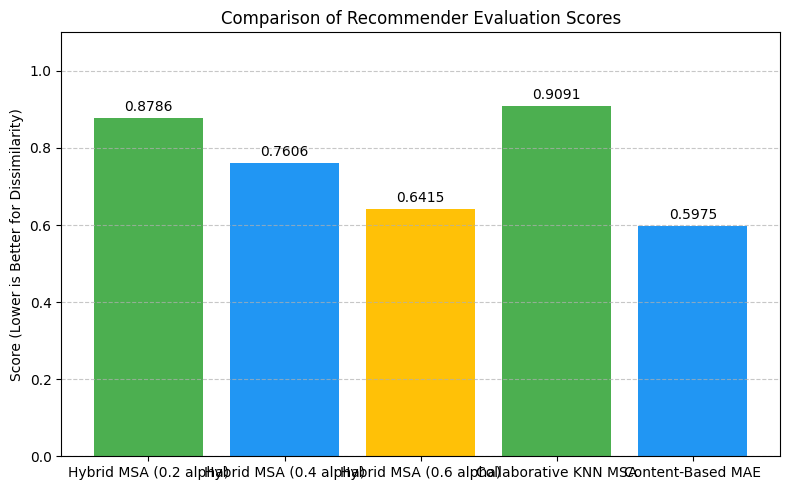

In [40]:

# Labels and values
labels = ['Hybrid MSA (0.2 alpha)','Hybrid MSA (0.4 alpha)','Hybrid MSA (0.6 alpha)', 'Collaborative KNN MSA', 'Content-Based MAE']
scores = [hybrid_average_msa_2,hybrid_average_msa_4, hybrid_average_msa, collaboratove_knn_msa, contentBased_MAE_score]

# Create the bar plot
plt.figure(figsize=(8, 5))
bars = plt.bar(labels, scores, color=['#4CAF50', '#2196F3', '#FFC107'])

# Add score labels on top of bars
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2.0, yval + 0.01, f'{yval:.4f}', ha='center', va='bottom')

plt.ylim(0, 1.1)
plt.title('Comparison of Recommender Evaluation Scores')
plt.ylabel('Score (Lower is Better for Dissimilarity)')
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()
